# Face Averaging

In [1]:
import dlib

import cv2
import numpy as np
import matplotlib
import math
from matplotlib import pyplot as plt
%matplotlib inline

In [2]:
# Utility functions

def read_image(file):
    file_name = './images/' + file
    im = cv2.imread(file_name)
    im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
    im = im / np.float64(255.0)
    return im

def convert_image_to_int(im):
    im = (im*255.0).astype('uint8')
    im[im>255] = 255
    im[im<0] = 0
    return im

def quick_show(im):
    if not np.issubdtype(im.dtype, np.uint8):
        im = convert_image_to_int(im)
    plt.figure(figsize = (10,10))
    plt.imshow(im)
    plt.show()

def blank_image(im):
    (h,w,c) = im.shape
    return np.zeros((h,w,c), np.float64)

def show_two(im1, im2):
    fig, axes = plt.subplots(1,2, figsize = (15,15))
    axes[0].imshow(im1)
    axes[1].imshow(im2)
    plt.show()


def show_all(im_list):
    n = len(im_list)
    
    y = int(math.ceil(n/3))
    if n > 3:
        x = 3
    else:
        x = n
    fig, axes = plt.subplots(y,x, figsize = (15,30))
    
    for i in range(len(im_list)):
        axes[math.floor(i/3)][i%3].imshow(im_list[i])
    plt.show()


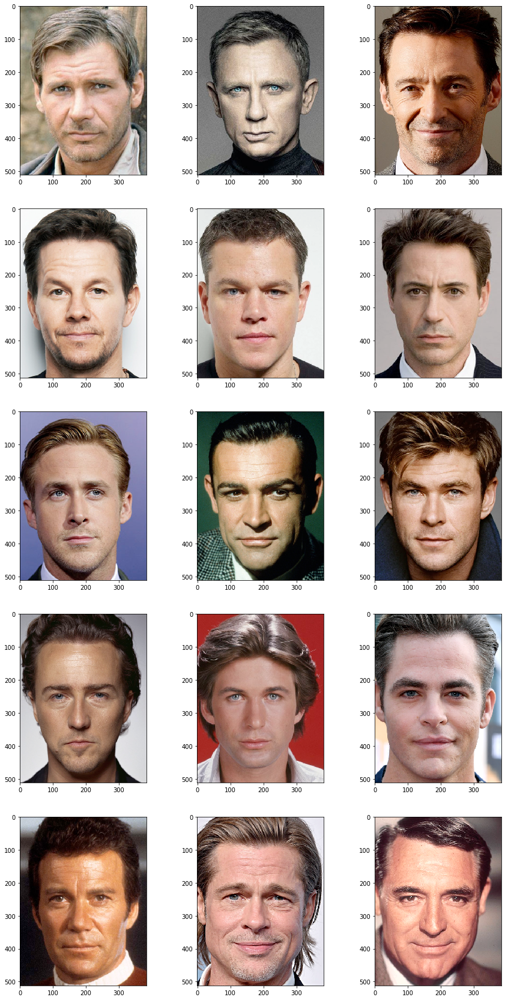

In [3]:
# Image data

daniel_craig = read_image('daniel_craig.png')
harrison_ford = read_image('harrison_ford.png')
hugh_jackman = read_image('hugh_jackman.png')
marky_mark = read_image('marky_mark.png')
matt_damon = read_image('matt_damon.png')
robert_downey_jr = read_image('robert_downey_jr.png')
ryan_gosling = read_image('ryan_gosling.png')
sean_connery = read_image('sean_connery.png')
chris_hemsworth = read_image('chris_hemsworth.png')
edward_norton = read_image('edward_norton.png')
alec_baldwin = read_image('alec_baldwin.png')
chris_pine = read_image('chris_pine.png')
william_shatner = read_image('william_shatner.png')
brad_pitt = read_image('brad_pitt.png')
carey_grant = read_image('carey_grant.png')


actors = [ harrison_ford,
           daniel_craig,
           hugh_jackman,
           marky_mark,
           matt_damon,
           robert_downey_jr,
           ryan_gosling,
           sean_connery,
           chris_hemsworth, edward_norton, alec_baldwin, chris_pine, william_shatner, brad_pitt, carey_grant]


show_all(actors)

tiger = read_image('tiger.png')
wolf = read_image('wolf.png')
monkey = read_image('monkey.png')
lion = read_image('lion.png')
bear = read_image('bear.png')

animals = [ tiger, wolf, monkey, lion, bear ]



## Facial Averages

### Simple Image Average

In [4]:
def simple_average(im_list):
    im = blank_image(im_list[0])
    for i in im_list:
        im += i
    im = im / len(actors)
    return im


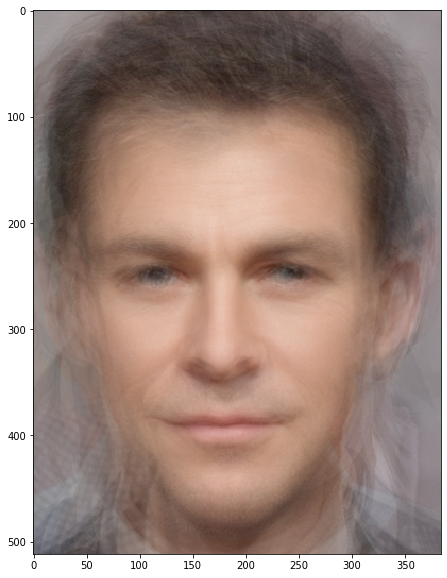

In [5]:

simple_average_actor = simple_average(actors)
quick_show(simple_average_actor)


### 68-point detection

In [65]:
def similarity_transform(in_points, out_points):

    s = math.sin(60.0 * math.pi / 180.0)
    c = math.cos(60.0 * math.pi / 180.0)

    i = np.copy(in_points).tolist()

    x_i = c * (i[0][0] - i[1][0]) - s * (i[0][1] - i[1][1]) + i[1][0]
    y_i = s * (i[0][0] - i[1][0]) + c * (i[0][1] - i[1][1]) + i[1][1]

    i.append([np.int(x_i), np.int(y_i)])


    o = np.copy(out_points).tolist()

    x_o = c * (o[0][0] - o[1][0]) - s * (o[0][1] - o[1][1]) + o[1][0]
    y_o = s * (o[0][0] - o[1][0]) + c * (o[0][1] - o[1][1]) + o[1][1]

    o.append([np.int(x_o), np.int(y_o)])

    return cv2.estimateAffinePartial2D(np.array([i]), np.array([o]))[0]


In [66]:
def sixty_eight_points(im_list):
    
    w = 1024
    h = 1024
    
    detector = dlib.get_frontal_face_detector()
    predictor = dlib.shape_predictor('shape_predictor_68_face_landmarks.dat')
    
    all_points = []
    
    all_point_images = []
    
    for im in im_list:
        im = convert_image_to_int(im)
        point_im = np.copy(im)
        detections = detector(im, 1)
        for k, d in enumerate(detections):
            results = []
            shape = predictor(im, d)
            for n in range(68):
                results.append((shape.part(n).x, shape.part(n).y))
                
                point_im = cv2.circle(point_im,
                                      (shape.part(n).x, shape.part(n).y),
                                      5,
                                      [255, 0, 0],
                                      thickness=2,
                                      lineType=8,
                                      shift=0) 
                
        all_points.append(results)
        all_point_images.append(point_im)
        
    if len(im_list) > 3:
        show_all(all_point_images)
    

    eye_destination = [ (np.int(0.3 * w), np.int(h / 3)), (np.int(0.7 * w), np.int(h / 3)) ]
    boundary_points = np.array([(0,0), (w/2,0), (w-1,0), (w-1,h/2), ( w-1, h-1 ), ( w/2, h-1 ), (0, h-1), (0,h/2) ])
    mean_points = np.array([(0, 0)] * (len(all_points[0]) + len(boundary_points)), np.float64())
    
    
    normalized_im_list = []
    normalized_points = []
    
    for i in range(len(im_list)):
        
        eye_source = [all_points[i][36], all_points[i][45]]
        transform = similarity_transform(eye_source, eye_destination)
        
        points = cv2.transform(np.reshape(np.array(all_points[i]), (68, 1, 2)), transform)
        points = np.float64(np.reshape(points, (68, 2)))
        points = np.append(points, boundary_points, axis=0)
        
        mean_points = mean_points + points / len(im_list)
        
        normalized_points.append(points)
        normalized_im_list.append(cv2.warpAffine(im_list[i], transform, (w, h)))

    if len(im_list) > 3:
        show_all(normalized_im_list)
    
    result = np.zeros((h, w, 3), np.float64())
    
    for i in range(len(normalized_im_list)):
        result += normalized_im_list[i]
        
    return result / len(normalized_im_list)


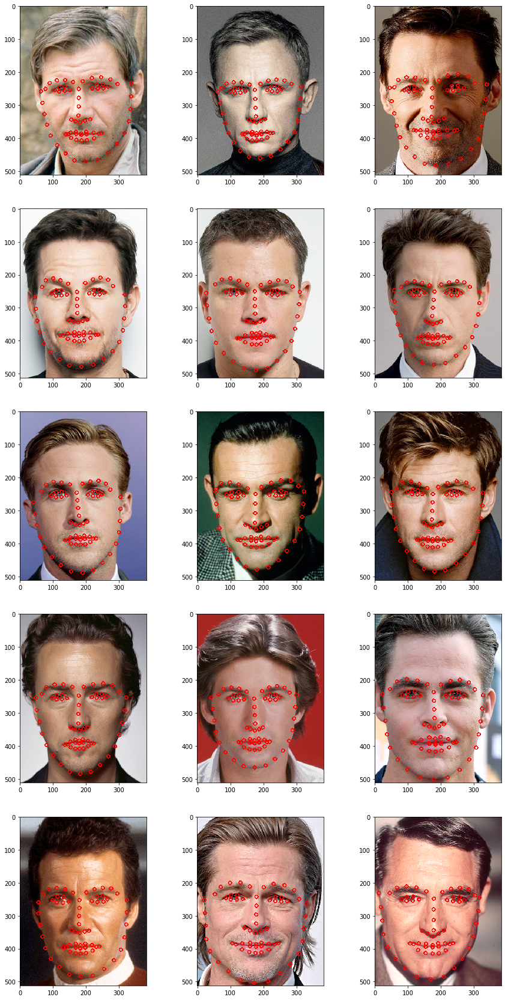

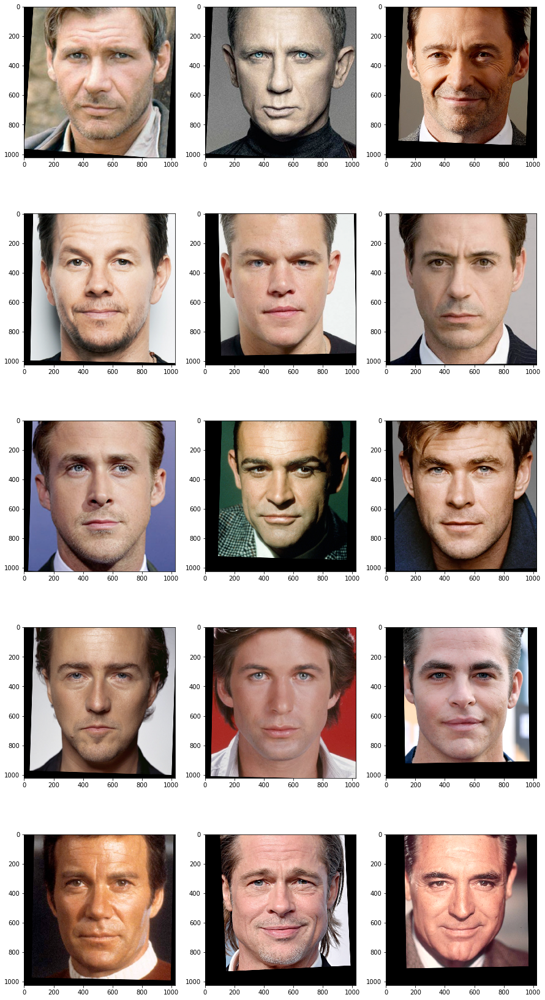

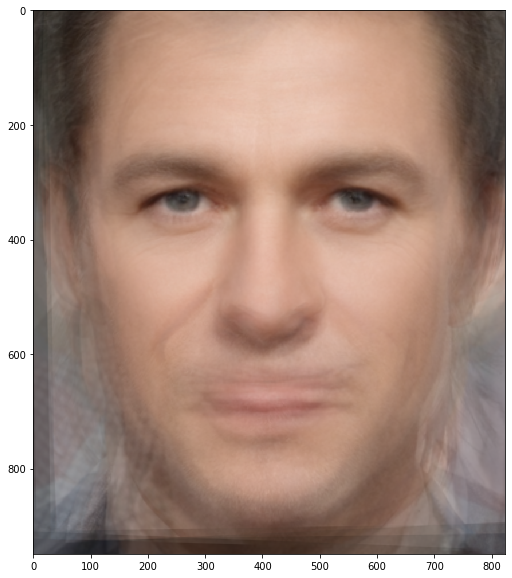

In [67]:
sixty_eight_pts_actor = sixty_eight_points(actors)
quick_show(sixty_eight_pts_actor[:-75,100:-100,:])


### Delaunay Triangles

In [23]:
def rect_contains(rect, point):
    if point[0] < rect[0]:
        return False
    elif point[1] < rect[1]:
        return False
    elif point[0] > rect[2]:
        return False
    elif point[1] > rect[3]:
        return False
    return True


In [24]:
def apply_affine_transform(source, source_triangle, destination_triangle, size):
    return cv2.warpAffine(source,
                          cv2.getAffineTransform(
                              np.float64(source_triangle),
                              np.float64(destination_triangle)),
                          (size[0], size[1]),
                          None,
                          flags=cv2.INTER_LINEAR,
                          borderMode=cv2.BORDER_REFLECT_101)


In [18]:
def warp_triangle(img1, img2, t1, t2):

    r1 = cv2.boundingRect(np.float64([t1]))
    r2 = cv2.boundingRect(np.float64([t2]))

    t1_rect = []
    t2_rect = []
    t2_rect_int = []

    for i in range(0, 3):
        t1_rect.append(((t1[i][0] - r1[0]), (t1[i][1] - r1[1])))
        t2_rect.append(((t2[i][0] - r2[0]), (t2[i][1] - r2[1])))
        t2_rect_int.append(((t2[i][0] - r2[0]), (t2[i][1] - r2[1])))


    mask = np.zeros((r2[3], r2[2], 3), dtype=np.float64)
    cv2.fillConvexPoly(mask, np.int32(t2_rect_int), (1.0, 1.0, 1.0), 16, 0)

    img1_rect = img1[r1[1]:r1[1] + r1[3], r1[0]:r1[0] + r1[2]]

    size = (r2[2], r2[3])

    img2_rect = apply_affine_transform(img1_rect, t1_rect, t2_rect, size)
    img2_rect = img2_rect * mask
    img2[r2[1]:r2[1] + r2[3], r2[0]:r2[0] + r2[2]] = img2[r2[1]:r2[1] + r2[3], r2[0]:r2[0] + r2[2]] * ((1.0, 1.0, 1.0) - mask)
    img2[r2[1]:r2[1] + r2[3], r2[0]:r2[0] + r2[2]] = img2[r2[1]:r2[1] + r2[3], r2[0]:r2[0] + r2[2]] + img2_rect


In [93]:
def delaunay_triangles(im_list):
    
    w = 1024
    h = 1024
    
    detector = dlib.get_frontal_face_detector()
    predictor = dlib.shape_predictor('shape_predictor_68_face_landmarks.dat')
    
    all_points = []
    
    all_point_images = []
    
    for im in im_list:
        im = convert_image_to_int(im)
        point_im = np.copy(im)
        detections = detector(im, 1)
        for k, d in enumerate(detections):
            results = []
            shape = predictor(im, d)
            for n in range(68):
                results.append((shape.part(n).x, shape.part(n).y))
                
                point_im = cv2.circle(point_im,
                                      (shape.part(n).x, shape.part(n).y),
                                      5,
                                      [255, 0, 0],
                                      thickness=2,
                                      lineType=8,
                                      shift=0) 
                
        all_points.append(results)
        all_point_images.append(point_im)
        
    if len(im_list) > 3:
        show_all(all_point_images)
    

    eye_destination = [ (np.int(0.3 * w), np.int(h / 3)), (np.int(0.7 * w), np.int(h / 3)) ]
    boundary_points = np.array([(0,0), (w/2,0), (w-1,0), (w-1,h/2), ( w-1, h-1 ), ( w/2, h-1 ), (0, h-1), (0,h/2) ])
    mean_points = np.array([(0, 0)] * (len(all_points[0]) + len(boundary_points)), np.float64())
    
    
    normalized_im_list = []
    normalized_points = []
    
    for i in range(len(im_list)):
        
        eye_source = [all_points[i][36], all_points[i][45]]
        transform = similarity_transform(eye_source, eye_destination)
        
        points = cv2.transform(np.reshape(np.array(all_points[i]), (68, 1, 2)), transform)
        points = np.float64(np.reshape(points, (68, 2)))
        points = np.append(points, boundary_points, axis=0)
        
        mean_points = mean_points + points / len(im_list)
        
        normalized_points.append(points)
        normalized_im_list.append(cv2.warpAffine(im_list[i], transform, (w, h)))

    if len(im_list) > 3:
        show_all(normalized_im_list)
    
    rect = (0, 0, w, h)


    subdiv = cv2.Subdiv2D(rect)
    for p in points:
        subdiv.insert((p[0], p[1]))

   
    triangle_list = subdiv.getTriangleList()

    delaunay_triangles = []
    
    triangle_faces = np.copy(normalized_im_list)
    
    for t in triangle_list:
        pt = []
        pt.append((t[0], t[1]))
        pt.append((t[2], t[3]))
        pt.append((t[4], t[5]))
        
        pt1 = (t[0], t[1])
        pt2 = (t[2], t[3])
        pt3 = (t[4], t[5])
        
        for i in range(len(triangle_faces)):

            triangle_faces[i] = cv2.line(triangle_faces[i],
                                         pt1, pt2,
                                         [1.0,0,0],
                                         thickness=3,
                                         lineType=cv2.LINE_AA,
                                         shift=0)
            
            triangle_faces[i] = cv2.line(triangle_faces[i],
                                         pt2, pt3,
                                         [1.0,0,0],
                                         thickness=3,
                                         lineType=cv2.LINE_AA,
                                         shift=0)
            
            triangle_faces[i] = cv2.line(triangle_faces[i],
                                         pt3, pt1,
                                         [1.0,0,0],
                                         thickness=3,
                                         lineType=cv2.LINE_AA,
                                         shift=0)
        
        if rect_contains(rect, pt1) and rect_contains(rect, pt2) and rect_contains(rect, pt3):
            ind = []
            for j in range(3):
                for k in range(len(points)):                    
                    if(abs(pt[j][0] - points[k][0]) < 1.0 and abs(pt[j][1] - points[k][1]) < 1.0):
                        ind.append(k)                            
            if len(ind) == 3:                                                
                delaunay_triangles.append((ind[0], ind[1], ind[2]))



    if len(im_list) > 3:
        show_all(triangle_faces)


    
    result = np.zeros((h, w, 3), np.float64())
    
    warped_faces = []
    
    for i in range(0, len(normalized_im_list)):
        
        im = np.zeros((h, w, 3), np.float64())
        
        for j in range(len(delaunay_triangles)):
            
            triangle1 = []
            triangle2 = []
            
            for k in range(3):
                
                triangle1.append((min(max(normalized_points[i][delaunay_triangles[j][k]][0], 0), w - 1),
                             min(max(normalized_points[i][delaunay_triangles[j][k]][1], 0), h - 1)))
                
                triangle2.append((min(max(mean_points[delaunay_triangles[j][k]][0], 0), w - 1),
                              min(max(mean_points[delaunay_triangles[j][k]][1], 0), h - 1)))

            warp_triangle(normalized_im_list[i], im, triangle1, triangle2)
            
        warped_faces.append(im)

        result = result + im

        
    fig, axes = plt.subplots(5,1, figsize = (5,30))
    axes[0].set_title('Original Image')
    axes[0].imshow(im_list[0])
    axes[1].set_title('Landmark Detection')
    axes[1].imshow(all_point_images[0])
    axes[2].set_title('Image Normalization')
    axes[2].imshow(normalized_im_list[0])
    axes[3].set_title('Triangle Mapping')
    axes[3].imshow(triangle_faces[0])
    axes[4].set_title('Affine Warping')
    axes[4].imshow(warped_faces[0])

    plt.show()


    
    return result / len(im_list)


<ipython-input-93-a6f8f9284ac1>:95: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  triangle_faces[i] = cv2.line(triangle_faces[i],
<ipython-input-93-a6f8f9284ac1>:102: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  triangle_faces[i] = cv2.line(triangle_faces[i],
<ipython-input-93-a6f8f9284ac1>:109: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  triangle_faces[i] = cv2.line(triangle_faces[i],


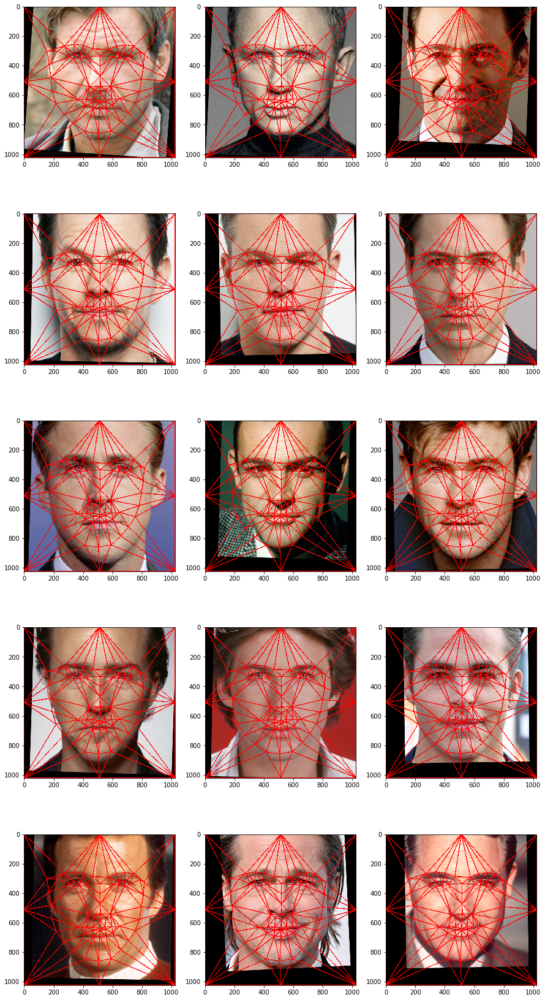

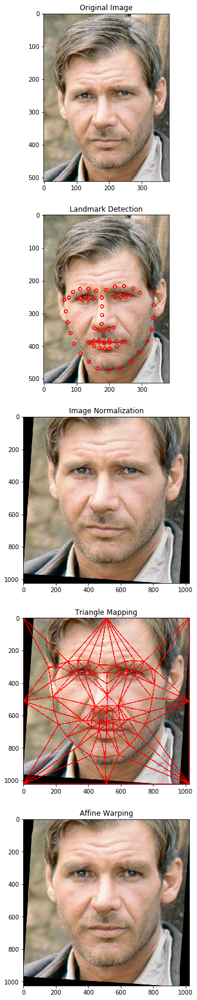

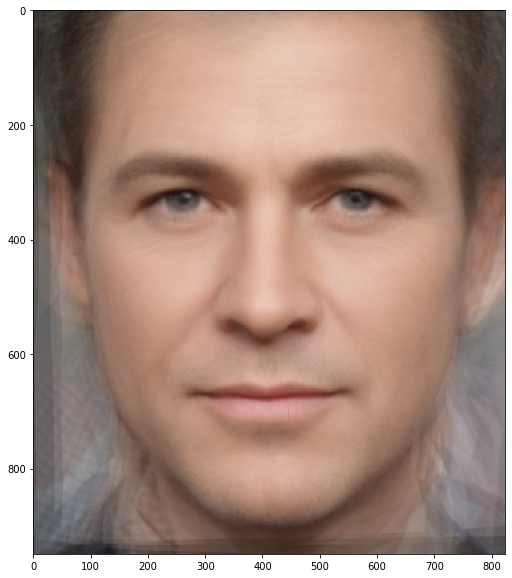

In [94]:
delaunay_triangles_actor = delaunay_triangles(actors)
quick_show(delaunay_triangles_actor[:-75,100:-100,:])



In [75]:
def eighty_one_points(im_list):
    
    w = 1024
    h = 1024
    
    detector = dlib.get_frontal_face_detector()
    predictor = dlib.shape_predictor('shape_predictor_81_face_landmarks.dat')
    
    all_points = []
    
    all_point_images = []
    
    for im in im_list:
        im = convert_image_to_int(im)
        point_im = np.copy(im)
        detections = detector(im, 0)
        for k, d in enumerate(detections):
            results = []
            shape = predictor(im, d)
            for n in range(81):
                results.append((shape.part(n).x, shape.part(n).y))
                
                point_im = cv2.circle(point_im,
                                      (shape.part(n).x, shape.part(n).y),
                                      5,
                                      [255, 0, 0],
                                      thickness=2,
                                      lineType=8,
                                      shift=0) 
                
        all_points.append(results)
        all_point_images.append(point_im)
        
    if len(im_list) > 3:
        show_all(all_point_images)
    

    eye_destination = [ (np.int(0.3 * w), np.int(h / 3)), (np.int(0.7 * w), np.int(h / 3)) ]
    boundary_points = np.array([(0,0), (w/2,0), (w-1,0), (w-1,h/2), ( w-1, h-1 ), ( w/2, h-1 ), (0, h-1), (0,h/2) ])
    mean_points = np.array([(0, 0)] * (len(all_points[0]) + len(boundary_points)), np.float64())
    
    
    normalized_im_list = []
    normalized_points = []
    
    for i in range(len(im_list)):
        
        eye_source = [all_points[i][36], all_points[i][45]]
        transform = similarity_transform(eye_source, eye_destination)
        
        points = cv2.transform(np.reshape(np.array(all_points[i]), (81, 1, 2)), transform)
        points = np.float64(np.reshape(points, (81, 2)))
        points = np.append(points, boundary_points, axis=0)
        
        mean_points = mean_points + points / len(im_list)
        
        normalized_points.append(points)
        normalized_im_list.append(cv2.warpAffine(im_list[i], transform, (w, h)))

    if len(im_list) > 3:
        show_all(normalized_im_list)
    
    rect = (0, 0, w, h)


    subdiv = cv2.Subdiv2D(rect)
    for p in points:
        subdiv.insert((p[0], p[1]))

    triangle_list = subdiv.getTriangleList()

    delaunay_triangles = []
    
    triangle_faces = np.copy(normalized_im_list)
    
    for t in triangle_list:
        pt = []
        pt.append((t[0], t[1]))
        pt.append((t[2], t[3]))
        pt.append((t[4], t[5]))
        
        pt1 = (t[0], t[1])
        pt2 = (t[2], t[3])
        pt3 = (t[4], t[5])
        
        for i in range(len(triangle_faces)):

            triangle_faces[i] = cv2.line(triangle_faces[i],
                                         pt1, pt2,
                                         [1.0,0,0],
                                         thickness=3,
                                         lineType=cv2.LINE_AA,
                                         shift=0)
            
            triangle_faces[i] = cv2.line(triangle_faces[i],
                                         pt2, pt3,
                                         [1.0,0,0],
                                         thickness=3,
                                         lineType=cv2.LINE_AA,
                                         shift=0)
            
            triangle_faces[i] = cv2.line(triangle_faces[i],
                                         pt3, pt1,
                                         [1.0,0,0],
                                         thickness=3,
                                         lineType=cv2.LINE_AA,
                                         shift=0)
        
        if rect_contains(rect, pt1) and rect_contains(rect, pt2) and rect_contains(rect, pt3):
            ind = []
            for j in range(3):
                for k in range(len(points)):                    
                    if(abs(pt[j][0] - points[k][0]) < 1.0 and abs(pt[j][1] - points[k][1]) < 1.0):
                        ind.append(k)                            
            if len(ind) == 3:                                                
                delaunay_triangles.append((ind[0], ind[1], ind[2]))



    if len(im_list) > 3:
        show_all(triangle_faces)


    
    result = np.zeros((h, w, 3), np.float64())
    
    warped_faces = []
      
    for i in range(0, len(normalized_im_list)):
        
        im = np.zeros((h, w, 3), np.float64())
        
        for j in range(len(delaunay_triangles)):
            
            triangle1 = []
            triangle2 = []
            
            for k in range(3):
                
                triangle1.append((min(max(normalized_points[i][delaunay_triangles[j][k]][0], 0), w - 1),
                             min(max(normalized_points[i][delaunay_triangles[j][k]][1], 0), h - 1)))
                
                triangle2.append((min(max(mean_points[delaunay_triangles[j][k]][0], 0), w - 1),
                              min(max(mean_points[delaunay_triangles[j][k]][1], 0), h - 1)))

            warp_triangle(normalized_im_list[i], im, triangle1, triangle2)
            
        warped_faces.append(im)

        result = result + im

    if len(im_list) > 3:
        show_all(warped_faces)


    
    return result / len(im_list)


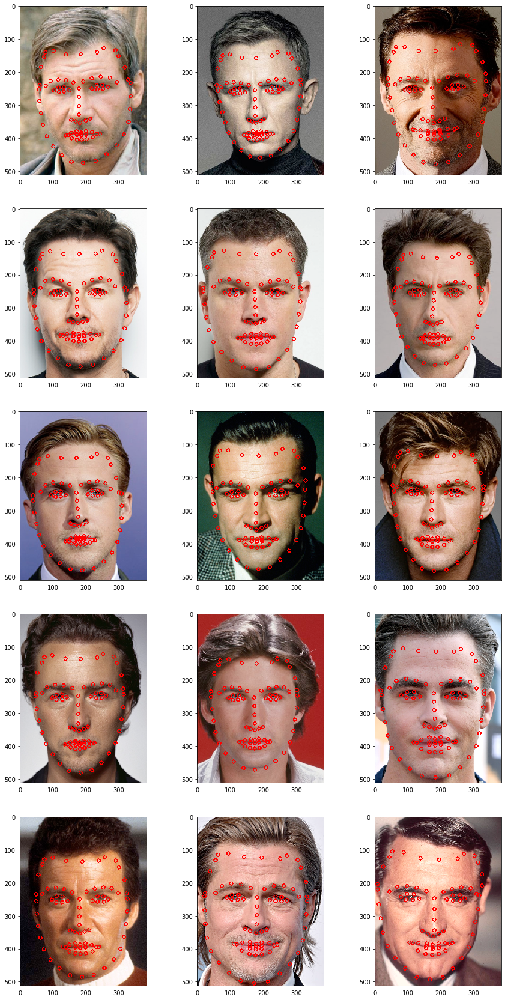

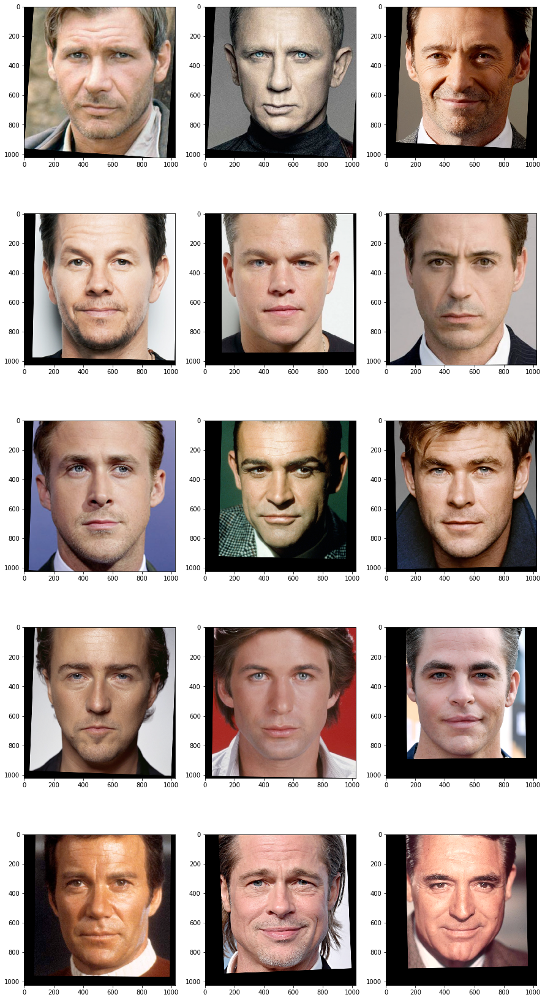

<ipython-input-75-30c5292f7f60>:95: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  triangle_faces[i] = cv2.line(triangle_faces[i],
<ipython-input-75-30c5292f7f60>:102: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  triangle_faces[i] = cv2.line(triangle_faces[i],
<ipython-input-75-30c5292f7f60>:109: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  triangle_faces[i] = cv2.line(triangle_faces[i],


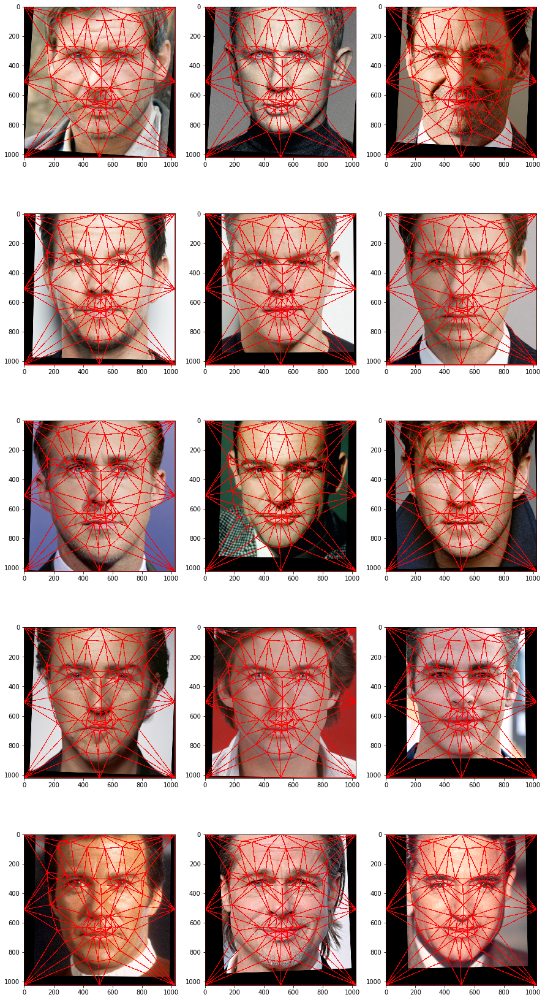

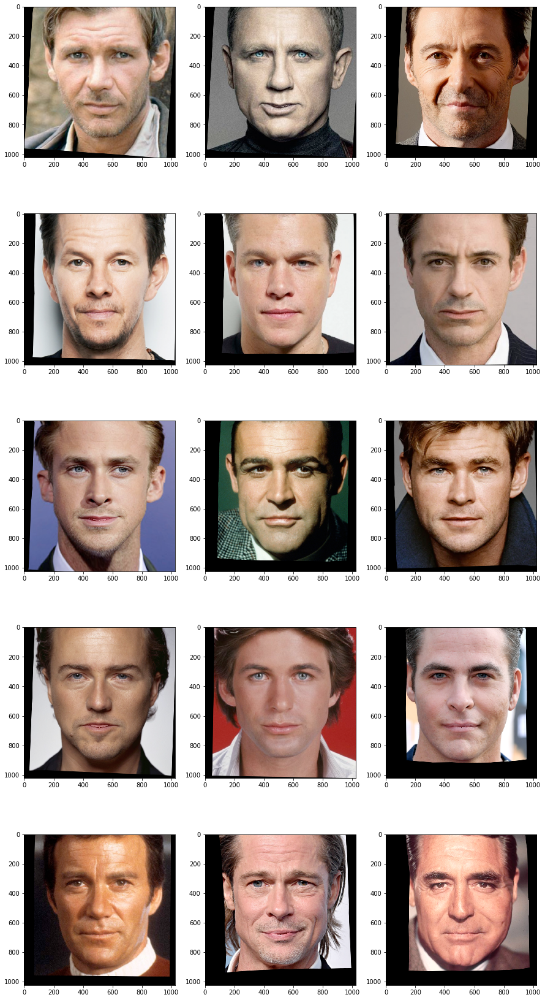

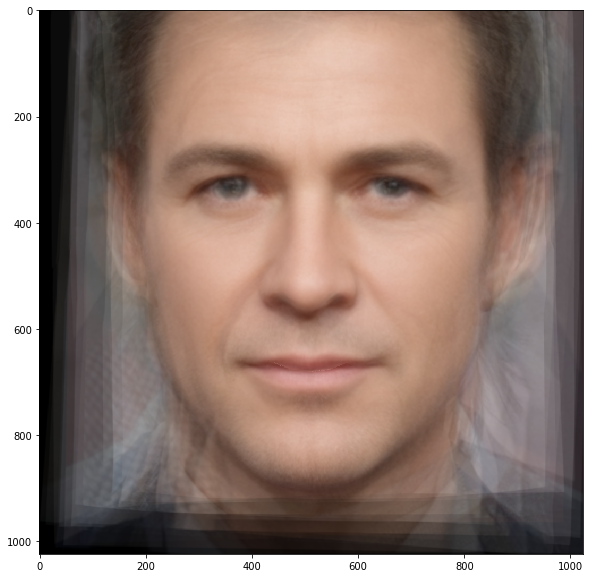

In [76]:
eighty_one_points_actor = eighty_one_points(actors)
quick_show(eighty_one_points_actor)


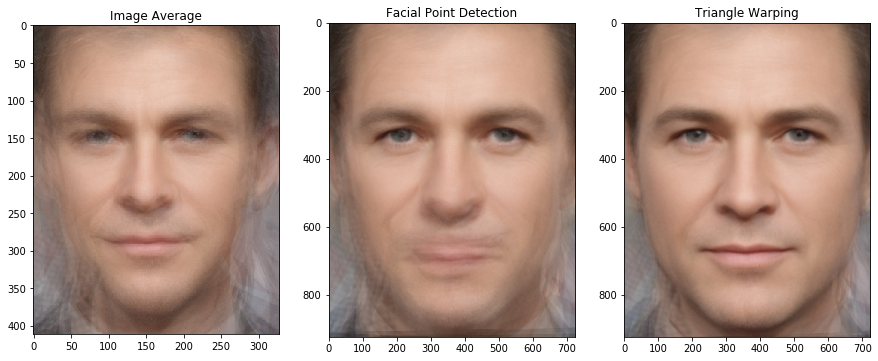

In [40]:
fig, axes = plt.subplots(1,3, figsize = (15,15))
axes[0].set_title('Image Average')
axes[0].imshow(simple_average_actor[100:,28:-28,:])
axes[1].set_title('Facial Point Detection')
axes[1].imshow(sixty_eight_pts_actor[:-100,150:-150,:])
axes[2].set_title('Triangle Warping')
axes[2].imshow(delaunay_triangles_actor[:-100,150:-150,:])
plt.show()


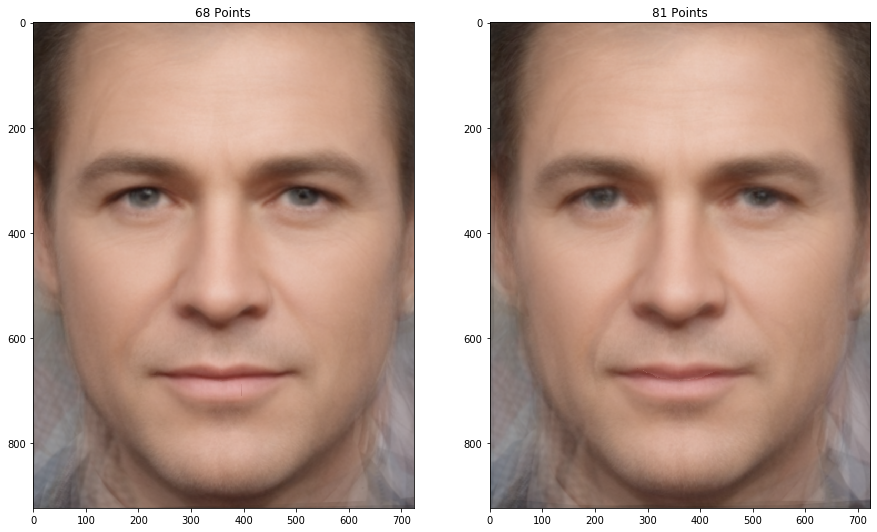

In [64]:
fig, axes = plt.subplots(1,2, figsize = (15,15))
axes[0].set_title('68 Points')
axes[0].imshow(delaunay_triangles_actor[:-100,150:-150,:])
axes[1].set_title('81 Points')
axes[1].imshow(eighty_one_points_actor[:-100,150:-150,:])
plt.show()


## Morphing

<ipython-input-25-a01d929f320f>:95: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  triangle_faces[i] = cv2.line(triangle_faces[i],
<ipython-input-25-a01d929f320f>:102: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  triangle_faces[i] = cv2.line(triangle_faces[i],
<ipython-input-25-a01d929f320f>:109: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  triangle_faces[i] = cv2.line(triangle_faces[i],


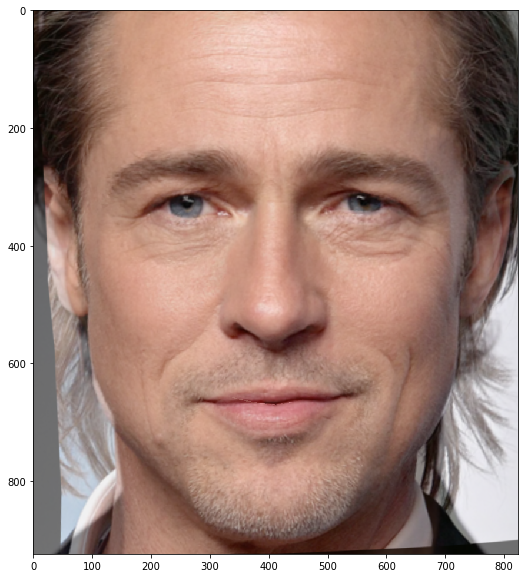

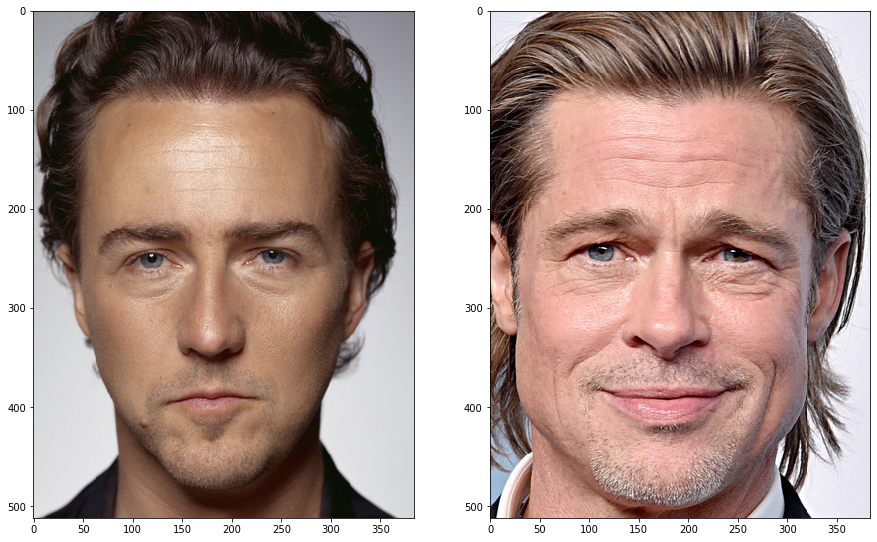

In [78]:
#scale_percent = 90 # percent of original size
#width = int(sixty_eight_pts_actor.shape[1] * scale_percent / 100)
#height = int(sixty_eight_pts_actor.shape[0] * scale_percent / 100)
#dim = (width, height)
# resize image
#resized = cv2.resize(sixty_eight_pts_actor, dim, interpolation = cv2.INTER_AREA)



fight_club = delaunay_triangles([edward_norton, brad_pitt])
quick_show(fight_club[:-100,100:-100,:])
show_two(edward_norton, brad_pitt)

<ipython-input-25-a01d929f320f>:95: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  triangle_faces[i] = cv2.line(triangle_faces[i],
<ipython-input-25-a01d929f320f>:102: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  triangle_faces[i] = cv2.line(triangle_faces[i],
<ipython-input-25-a01d929f320f>:109: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  triangle_faces[i] = cv2.line(triangle_faces[i],


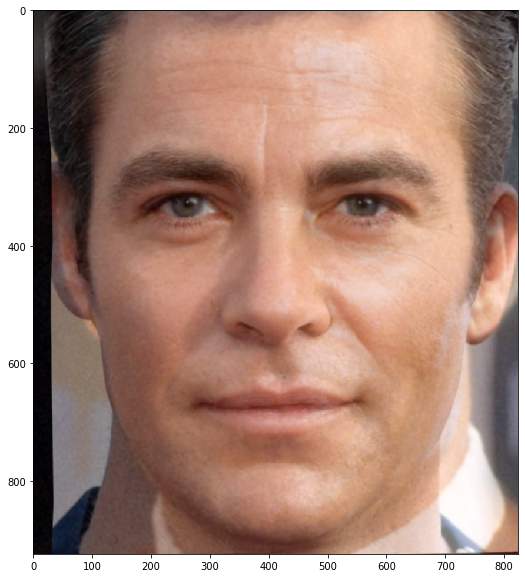

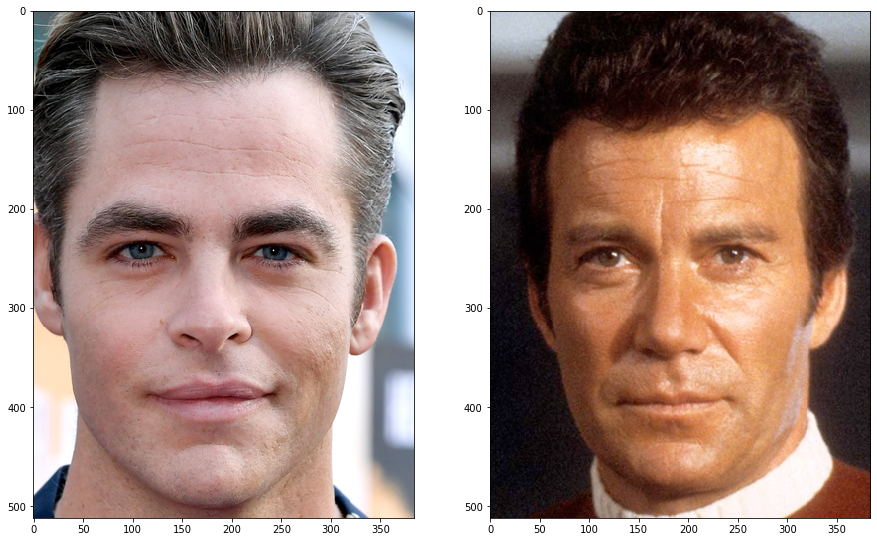

In [79]:
#scale_percent = 40 # percent of original size
#width = int(sixty_eight_pts_actor.shape[1] * scale_percent / 100)
#height = int(sixty_eight_pts_actor.shape[0] * scale_percent / 100)
#dim = (width, height)
# resize image
#resized = cv2.resize(sixty_eight_pts_actor, dim, interpolation = cv2.INTER_AREA)


captains_kirk = delaunay_triangles([chris_pine, william_shatner])
quick_show(captains_kirk[:-100,100:-100,:])

show_two(chris_pine, william_shatner)

<ipython-input-25-a01d929f320f>:95: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  triangle_faces[i] = cv2.line(triangle_faces[i],
<ipython-input-25-a01d929f320f>:102: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  triangle_faces[i] = cv2.line(triangle_faces[i],
<ipython-input-25-a01d929f320f>:109: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  triangle_faces[i] = cv2.line(triangle_faces[i],


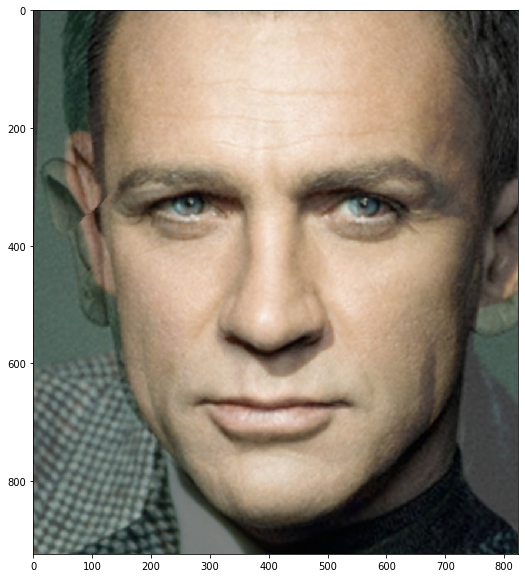

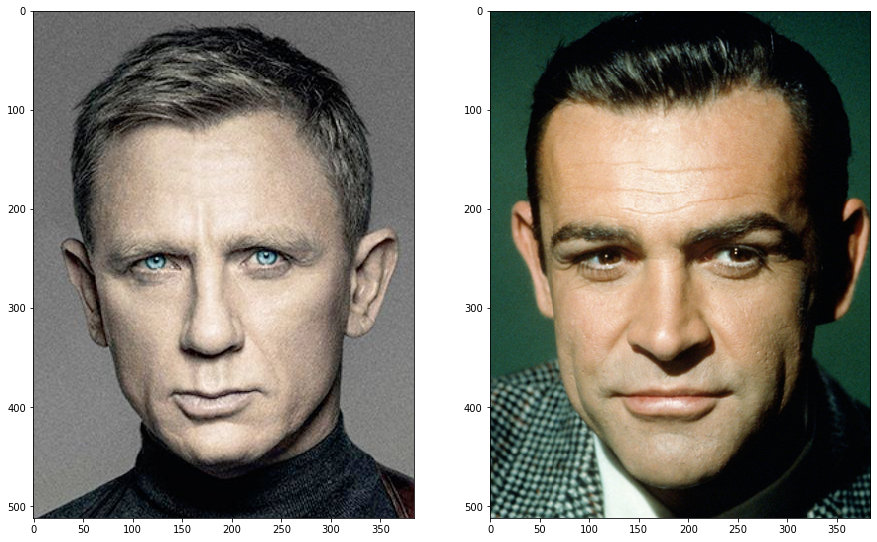

In [80]:
james_bonds = delaunay_triangles([daniel_craig, sean_connery])
quick_show(james_bonds[:-100,100:-100,:])

show_two(daniel_craig, sean_connery)

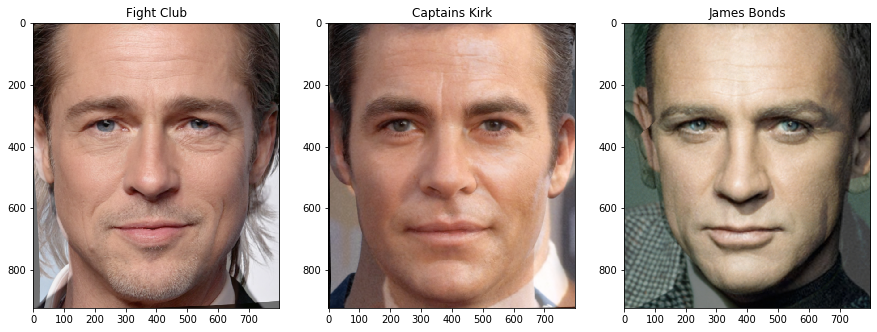

In [84]:
fig, axes = plt.subplots(1,3, figsize = (15,15))
axes[0].set_title('Fight Club')
axes[0].imshow(fight_club[:-100,125:-100,:])
axes[1].set_title('Captains Kirk')
axes[1].imshow(captains_kirk[:-100,125:-100,:])
axes[2].set_title('James Bonds')
axes[2].imshow(james_bonds[:-100,125:-100,:])
plt.show()
